In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

In [2]:
df = pd.read_csv('data_train.csv').values
df

array([[ 2, 13],
       [ 7, 35],
       [ 9, 41],
       [ 3, 19],
       [10, 45],
       [ 6, 28],
       [ 1, 10],
       [ 8, 55]], dtype=int64)

In [4]:
X_train = np.array(df[:,:1])
X0 = X_train
Y_train = np.array(df[:,1:])
print(X_train)
print(Y_train)

[[ 2]
 [ 7]
 [ 9]
 [ 3]
 [10]
 [ 6]
 [ 1]
 [ 8]]
[[13]
 [35]
 [41]
 [19]
 [45]
 [28]
 [10]
 [55]]


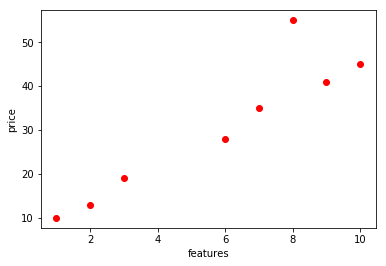

In [5]:
%matplotlib inline
plt.xlabel('features')
plt.ylabel('price')
plt.scatter(X_train,Y_train,c='r')
plt.show()

In [13]:
ones = np.ones_like(X_train)
X_train = np.concatenate((X_train, ones), axis=1)
X_train

array([[ 2,  1],
       [ 7,  1],
       [ 9,  1],
       [ 3,  1],
       [10,  1],
       [ 6,  1],
       [ 1,  1],
       [ 8,  1]], dtype=int64)

In [14]:
m = X_train.shape[0]
m

8

In [15]:
theta_gd = np.random.normal(size=2).reshape([2,1])
theta_gd

array([[-1.77317398],
       [-0.74550256]])

In [16]:
learning_rate = 0.02

In [17]:
def grad_cal(X, Y, theta_gd, m):
    """
    X: X's value
    Y: Y's value
    theta_gd: theta's value
    m: number of samples
    """    
    g = 1/m * X.T.dot(X.dot(theta_gd) - Y)
    return g.reshape(theta_gd.shape)
def loss(X, Y, theta_gd, m):
    """
    X: X's value
    Y: Y's value
    theta_gd: theta's value
    m: number of samples
    """
    return 1/(2*m) * np.sum((X.dot(theta_gd) - Y)**2)

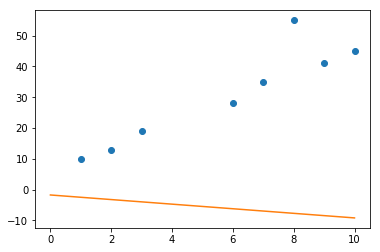

In [18]:
# We do not need pay much attention on this part
def plot_polynomial(xmin, xmax, coef, color='C1'):
    #xs is an array of evenly spaced numbers between xmin and xmax
    xs = np.linspace(xmin, xmax, num=500)
    
    #ys is an array, each element is computed as a polynomial function of
    #the corresponding element of xs
    ys = np.zeros_like(xs)
    for p, c in enumerate(coef.flatten()):
        ys += c*np.power(xs, p)
    plt.plot(xs, ys, color=color)

def ve():
    plt.scatter(X0, Y_train)
    plot_polynomial(0,10,theta_gd)
    plt.show()
ve()

đoạn thẳng khi random theta_gd

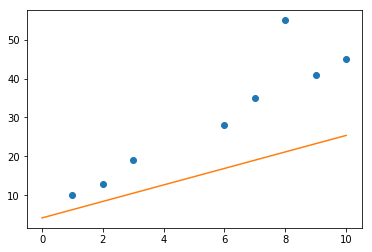

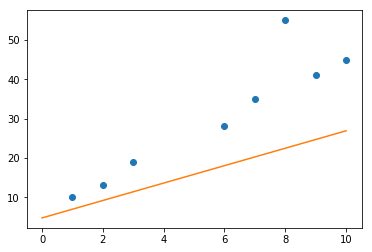

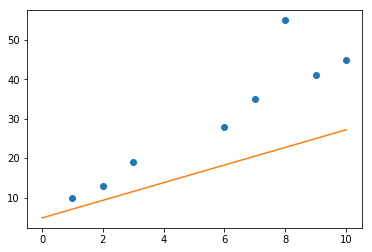

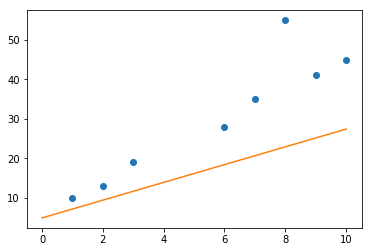

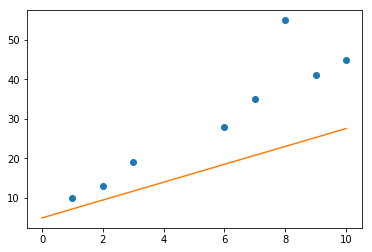

...

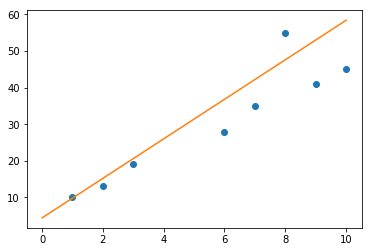

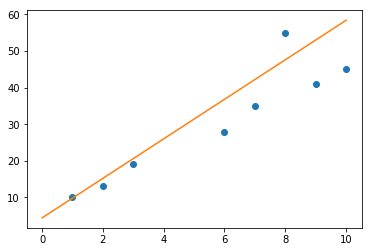

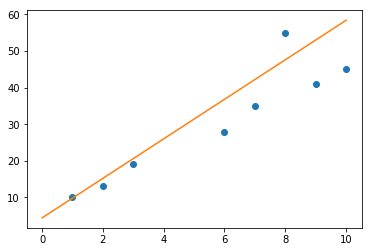

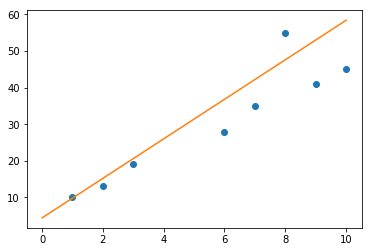

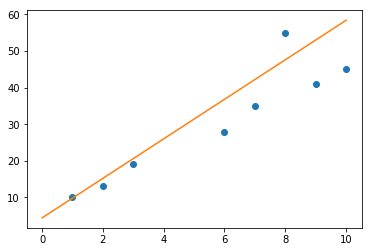

KeyboardInterrupt: 

<Figure size 432x288 with 0 Axes>

In [24]:
loss_list = []
theta_gd = np.random.normal(size=2).reshape([2,1])
for i in range(10000):
    grad_value = grad_cal(X_train, Y_train, theta_gd, m)
    theta_gd = theta_gd - learning_rate*grad_value
    ve()
    loss_list.append(loss(X_train, Y_train, theta_gd, m))

In [25]:
theta_gd

array([[4.40880503],
       [5.39937106]])

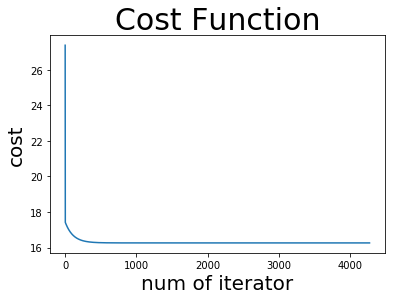

In [26]:
plt.title('Cost Function', size = 30)
plt.xlabel('num of iterator', size = 20)
plt.ylabel('cost', size = 20)
plt.plot(loss_list)
plt.show()

In [28]:
def predict(X):
    return X.dot(theta_gd)
X_new_1 = np.array([[20, 1]])
predict(X_new_1)

array([[93.57547172]])

In [29]:
from sklearn import datasets, linear_model